## Notebook for the Control Data (from Gut Cell Atlas) processing 
### Developed by: Anna Maguza

### Institute of Computational Biology - Computational Health Centre - Hemlholtz Munich

### 15 October 2022

#### Load required packages

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as an
import scrublet
from matplotlib.pyplot import figure

#### Setup Cells

In [2]:
%matplotlib inline

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.6 scipy==1.8.1 pandas==1.4.2 scikit-learn==1.1.1 statsmodels==0.13.2 python-igraph==0.9.11 louvain==0.7.1 pynndescent==0.5.7


#### Upload Data

In [4]:
#Loading again to further processing
input_Normal_file = '/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/Full_obj_raw_counts_nosoupx_v2.h5ad'  # the file that will store the analysis results
output_Normal_file = '/Users/annamaguza/Desktop/Desktop-Anna/LMU/Master-Thesis/Anna-Master-Project/Full_obj_raw_counts_nosoupx_v2.h5ad'  # the file that will store the analysis results

In [5]:
#Anndata upload
control_ad = sc.read_h5ad(input_Normal_file)
control_ad.X

<428469x33538 sparse matrix of type '<class 'numpy.float32'>'
	with 760344941 stored elements in Compressed Sparse Row format>

In [6]:
control_ad.var

,gene_ids,feature_types
MIR1302-2HG,ENSG00000243485,Gene Expression
FAM138A,ENSG00000237613,Gene Expression
OR4F5,ENSG00000186092,Gene Expression
AL627309.1,ENSG00000238009,Gene Expression
AL627309.3,ENSG00000239945,Gene Expression
...,...,...
AC233755.2,ENSG00000277856,Gene Expression
AC233755.1,ENSG00000275063,Gene Expression
AC240274.1,ENSG00000271254,Gene Expression
AC213203.1,ENSG00000277475,Gene Expression


In [7]:
control_ad.obs

,Sample name,Diagnosis,Age,sample name,Region code,Fraction,Gender,Region,10X,batch,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,doublet_scores,predicted_doublets,category,Age_group,Integrated_05
AAACCTGAGAACAACT-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,968,968,1912.793579,46.228199,2.416790,0.016442,False,B cells,Pediatric,DZ GC cell
AAACCTGAGCGATATA-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,693,693,2152.089355,0.122579,0.005696,0.027389,False,B cells,Pediatric,Cycling B cell
AAACCTGAGGAGTTTA-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,720,720,1686.883423,80.195816,4.754082,0.014817,False,T cells,Pediatric,gdT
AAACCTGAGTATCTCG-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,746,746,2135.183838,104.506760,4.894509,0.039416,False,B cells,Pediatric,Memory B
AAACCTGAGTGACTCT-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,1227,1227,3103.050293,95.846077,3.088770,0.025763,False,B cells,Pediatric,DZ GC cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTTCAACACGT-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,1821,1821,4838.415039,144.966095,2.996148,0.027510,False,Mesenchymal,Adult,Stromal 1 (CCL11+)
TTTGGTTTCCAAATGC-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,1814,1814,5337.013672,85.408028,1.600296,0.014349,False,Mesenchymal,Adult,Stromal 1 (CCL11+)
TTTGGTTTCGGCGGTT-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,6418,6418,48142.085938,7198.451172,14.952512,0.072750,False,Epithelial,Adult,Colonocyte
TTTGTCAGTGAAAGAG-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,2578,2578,10848.547852,600.362671,5.534037,0.091348,False,Epithelial,Adult,Stem cells


In [8]:
#Remove Pediatric Crohn Disease
control_ad_clean = control_ad[~control_ad.obs['Diagnosis'].isin(['Pediatric Crohn Disease']),:]
#Deleting the lymph node samples
control_ad_clean = control_ad_clean[~control_ad_clean.obs['Region'].isin(['lymph node']),:]

In [9]:
del control_ad

In [10]:
#Adding percentage of ribosomial genes
control_ad_clean.var['ribo'] = control_ad_clean.var_names.str.startswith(("RPS","RPL"))  # annotate the group of ribosomal genes as 'ribo'
sc.pp.calculate_qc_metrics(control_ad_clean, qc_vars=['ribo'], percent_top=None, log1p=False, inplace=True)

/var/folders/qc/2mwywtjd73z8jw_s09vv_kzm0000gn/T/ipykernel_47657/662404065.py:2: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  control_ad_clean.var['ribo'] = control_ad_clean.var_names.str.startswith(("RPS","RPL"))  # annotate the group of ribosomal genes as 'ribo'


In [11]:
#Total Counts
sum(control_ad_clean.obs.total_counts)

2521553659.0

In [12]:
#Mean Genes per Cell
sum(control_ad_clean.obs.n_genes_by_counts)/401305

1737.4227383162433

In [13]:
#Mean Reads per Cell
sum(control_ad_clean.obs.total_counts)/401305

6283.384605225452

In [14]:
#Mean percentage of mitochondrial counts
from statistics import mean
mean(control_ad_clean.obs.pct_counts_mt)

9.818887195353023

In [15]:
#Mean percentage of ribosomial counts
from statistics import mean
mean(control_ad_clean.obs.pct_counts_ribo)

23.282191512571586

#### Quality Parameters Visualization

normalizing counts per cell
    finished (0:00:13)


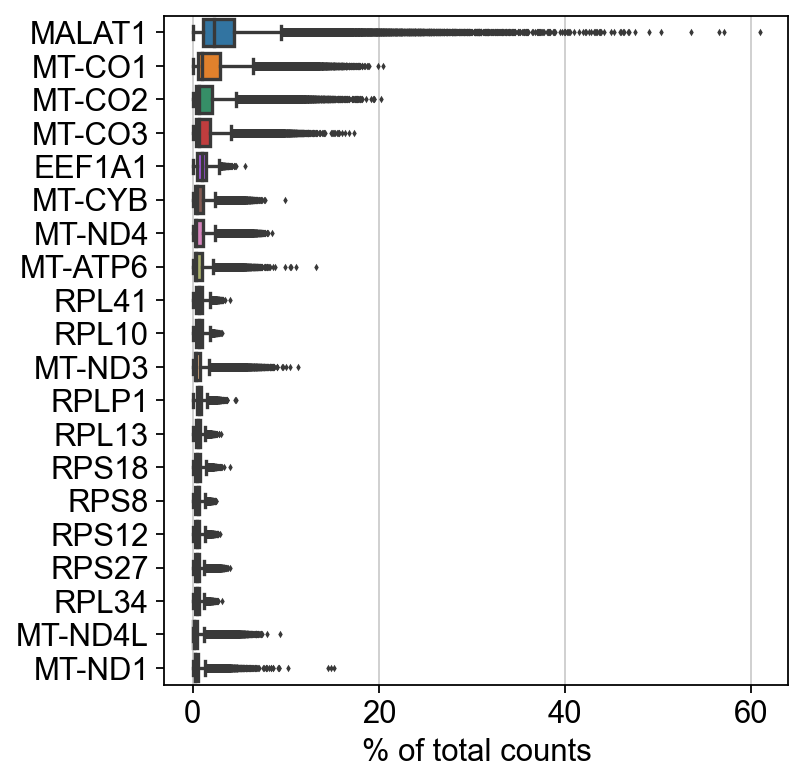

In [16]:
#Show those genes that yield the highest fraction of counts in each single cell, across all cells
sc.pl.highest_expr_genes(control_ad_clean, n_top=20, )

In [ ]:
#A violin plot of some of the computed quality measures:
    # the number of genes expressed in the count matrix
    #the total counts per cell
    #the percentage of counts in mitochondrial genes
    #the percentage of counts in ribosomial genes
sc.pl.violin(control_ad_clean, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo'],
             jitter=0.4, multi_panel=True)

In [ ]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(20, 15), dpi=80)
sc.pl.violin(control_ad_clean, ['n_genes_by_counts'],
             jitter=0.4, groupby = 'Sample name', rotation = 90)

In [ ]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(20, 15), dpi=80)
sc.pl.violin(control_ad_clean, ['total_counts'],
             jitter=0.4, groupby = 'Sample name', rotation = 90)

In [ ]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(20, 15), dpi=80)
sc.pl.violin(control_ad_clean, ['pct_counts_mt'],
             jitter=0.4, groupby = 'Sample name', rotation = 90)

In [ ]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(20, 15), dpi=80)
sc.pl.violin(control_ad_clean, ['pct_counts_ribo'],
             jitter=0.4, groupby = 'Sample name', rotation = 90)

In [ ]:
#Check Quality Metrics by Сondition
#Create visualisation of QC covariates for condition
sc.set_figure_params(figsize=(5, 4), dpi=80)
sc.pl.violin(control_ad_clean, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo'],
             jitter=0.4, groupby = 'Diagnosis', rotation = 90)

In [ ]:
#Check Quality Metrics by Region
#Create visualisation of QC covariates for Region
sc.set_figure_params(figsize=(5, 4), dpi=80)
sc.pl.violin(control_ad_clean, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo'],
             jitter=0.4, groupby = 'Region', rotation = 90)

#### Cleaning the data 

In [20]:
#Filtering by genes
control_ad_clean2 = control_ad_clean[control_ad_clean.obs.n_genes_by_counts < 5000, :]
control_ad_clean2 = control_ad_clean2[control_ad_clean2.obs.n_genes_by_counts > 200, :]

In [21]:
del control_ad_clean 

In [ ]:
#A violin plot of some of the computed quality measures:
    # the number of genes expressed in the count matrix
    #the total counts per cell
    #the percentage of counts in mitochondrial genes
    #the percentage of counts in ribosomial genes
sc.pl.violin(control_ad_clean2, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo'],
             jitter=0.4, multi_panel=True)

In [ ]:
#Check Quality Metrics by Сondition
#Create visualisation of QC covariates for condition
sc.set_figure_params(figsize=(5, 6), dpi=80)
sc.pl.violin(control_ad_clean2, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo'],
             jitter=0.4, groupby = 'Diagnosis', rotation = 90)

In [ ]:
#Check Quality Metrics by Region
#Create visualisation of QC covariates for Region
sc.set_figure_params(figsize=(5, 4), dpi=80)
sc.pl.violin(control_ad_clean2, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo'],
             jitter=0.4, groupby = 'Region', rotation = 90)

In [ ]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(20, 15), dpi=80)
sc.pl.violin(control_ad_clean2, ['n_genes_by_counts'],
             jitter=0.4, groupby = 'Sample name', rotation = 90)

In [ ]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(20, 15), dpi=80)
sc.pl.violin(control_ad_clean2, ['total_counts'],
             jitter=0.4, groupby = 'Sample name', rotation = 90)

In [ ]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(20, 15), dpi=80)
sc.pl.violin(control_ad_clean2, ['pct_counts_mt'],
             jitter=0.4, groupby = 'Sample name', rotation = 90)

In [ ]:
#Check Quality Metrics by Samples
#Create visualisation of QC covariates for samples
sc.set_figure_params(figsize=(20, 15), dpi=80)
sc.pl.violin(control_ad_clean2, ['pct_counts_ribo'],
             jitter=0.4, groupby = 'Sample name', rotation = 90)

In [22]:
control_ad_clean2 = control_ad_clean2[control_ad_clean2.obs.total_counts < 50000, :]

#### UMAP plots

In [34]:
#Identification of hightly variable genes to run UMAP
sc.pp.highly_variable_genes(control_ad_clean2, flavor = 'seurat_v3', n_top_genes=7000)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [35]:
#Neighbors calculating for UMAp
sc.pp.neighbors(control_ad_clean2, n_neighbors = 50, n_pcs = 50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:00)


In [36]:
#UMAP with QC parameters
sc.tl.umap(control_ad_clean2)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:12:21)


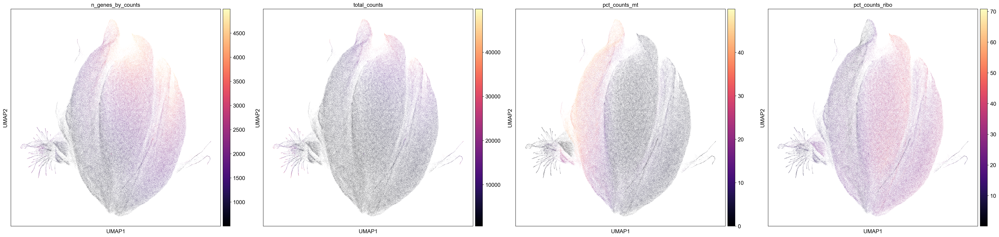

In [37]:
#UMAP with QC parameters
sc.set_figure_params(figsize=(10, 10),dpi=100)
sc.pl.umap(control_ad_clean2, color_map = "magma", color=['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo'])

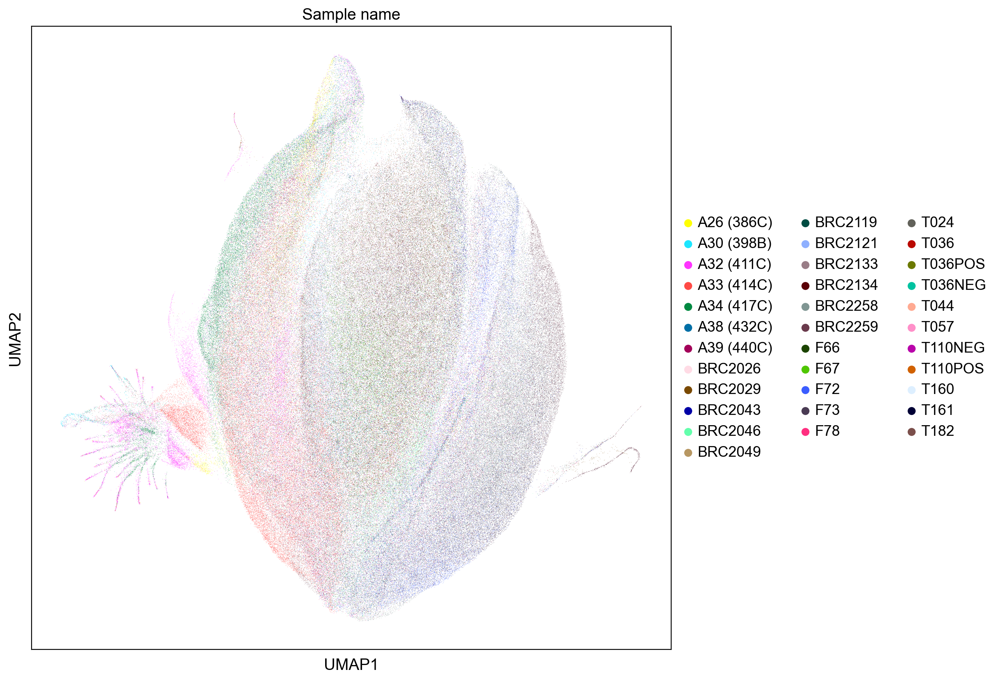

In [30]:
#UMAP with samples
sc.set_figure_params(figsize=(10, 10),dpi=100)
sc.pl.umap(control_ad_clean2, color_map = "magma", color=["Sample name"])

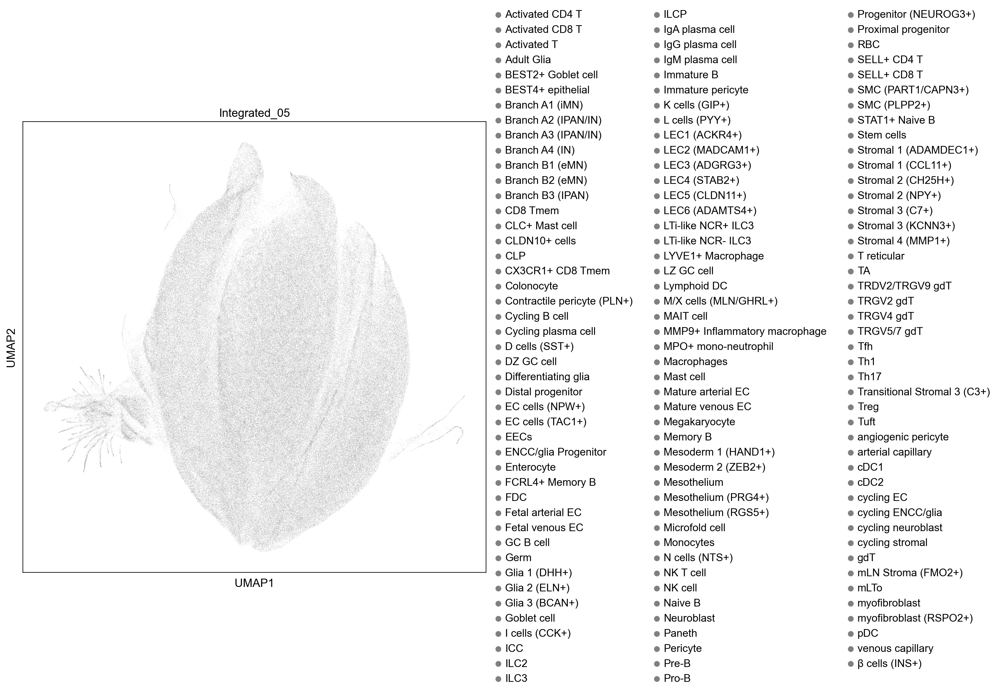

In [32]:
#UMAP with samples
sc.set_figure_params(figsize=(10, 10),dpi=100)
sc.pl.umap(control_ad_clean2, color=["Integrated_05"])

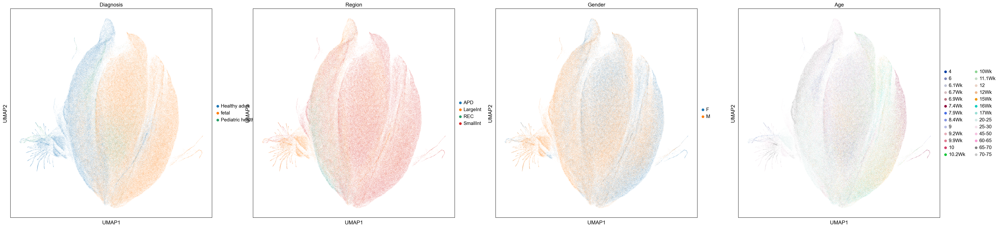

In [33]:
#UMAP with QC parameters
sc.pl.umap(control_ad_clean2, color_map = "magma", color=["Diagnosis", "Region", "Gender", "Age"])

### Doublets identification with scrublet

In [ ]:
%matplotlib inline
scrub = scrublet.Scrublet(control_ad_clean.X)

In [ ]:
%matplotlib inline
control_ad_clean.obs['doublet_scores'], control_ad_clean.obs['predicted_doublets'] = scrub.scrub_doublets()
scrub.plot_histogram()

In [ ]:
%matplotlib inline
sum(control_ad_clean.obs['predicted_doublets'])

In [ ]:
# add in column with singlet/doublet instead of True/False
control_ad_clean.obs['doublet_info'] = control_ad_clean.obs["predicted_doublets"].astype(str)

In [ ]:
%matplotlib inline
#check if our predicted doublets also have more detected genes in general
sc.pl.violin(control_ad_clean, 'n_genes_by_counts',
             jitter=0.4, groupby = 'doublet_info', rotation=45)

#### Filtering 